References:
- InfinityAI


# test out on synthetic fitness videos

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub
from tensorflow_docs.vis import embed
import numpy as np
import pandas as pd
from scipy import stats
import cv2
import yaml
import os
import glob
import pickle as pkl
import sys
import importlib

In [ ]:
# load yaml configuration file w/ keypoints dict ()
# assumes ..\ is root of project
# e.g. C:\MLprojects\motion_analysis\configs\config_analysis.yaml

# set up paths
ROOT_DIR = r"c:\MLprojects\motion_analysis"
CONFIG_DIR = "configs"

def load_config(config_name):
    with open(os.path.join(ROOT_DIR, CONFIG_DIR, config_name)) as file:
        config = yaml.full_load(file)
    return config

CONFIG_KEYPOINTS = load_config(r"keypoints.yaml")
CONFIG_EDGE_COLORS = load_config(r"edge_colors.yaml")
PARAMS = load_config(r"analysis_parameters.yaml")

# Confidence score to determine whether a keypoint prediction is reliable, e.g. for cropping algorithm during inference
KEYPOINT_THRESH_SCORE_CROP = load_config('analysis_parameters.yaml')['KEYPOINT_THRESH_SCORE_CROP']


In [ ]:
os.chdir(ROOT_DIR)

In [ ]:
# custom modules
from src.io import iomod
from src.inference import inference
from src.visualization import draw
from src.analysis import analysisphysics
from src.tests import testdraw, structshape

# Import plotting libraries
from matplotlib import pyplot as plt
from matplotlib.collections import LineCollection # likely limited to draw module
import matplotlib.patches as patches
import seaborn as sns

# Some modules to display an animation using imageio.
import imageio
from IPython.display import HTML, display, Image

notes:

In [ ]:
'''
loads into dictionaries of keypoints and edges mappings, e.g.:

CONFIG_KEYPOINTS = {
    'nose': 0,
    'left_eye': 1,
    'right_eye': 2,
    'left_ear': 3,
    'right_ear': 4,
    'left_shoulder': 5,
    'right_shoulder': 6,
    'left_elbow': 7,
    'right_elbow': 8,
    'left_wrist': 9,
    'right_wrist': 10,
    'left_hip': 11,
    'right_hip': 12,
    'left_knee': 13,
    'right_knee': 14,
    'left_ankle': 15,
    'right_ankle': 16
}

CONFIG_EDGE_COLORS is an ordered dictionary of edge pairs and colors, e.g.:
OrderedDict([((0, 1), 'm'),
             ((0, 2), 'c'),
             ((0, 5), 'm'),
             ((0, 6), 'c'),
             ((1, 3), 'm'),
             ((2, 4), 'c'),
             ((5, 6), 'y'),
             ((5, 7), 'm'),
             ((5, 11), 'm'),
             ((6, 8), 'c'),
             ((6, 12), 'c'),
             ((7, 9), 'm'),
             ((8, 10), 'c'),
             ((11, 12), 'y'),
             ((11, 13), 'm'),
             ((12, 14), 'c'),
             ((13, 15), 'm'),
             ((14, 16), 'c')])

# use e.g. list(CONFIG_EDGE_COLORS).index((2,4)) to get index of edge color

'''
;

From Documentation:

movenet outputs a float32 tensor of shape [1, 1, 17, 3].

The first two channels of the last dimension represents the yx coordinates (normalized to image frame, i.e. range in [0.0, 1.0]) of the 17 keypoints (in the order of: [nose, left eye, right eye, left ear, right ear, left shoulder, right shoulder, left elbow, right elbow, left wrist, right wrist, left hip, right hip, left knee, right knee, left ankle, right ankle]).

The third channel of the last dimension represents the prediction confidence scores of each keypoint, also in the range [0.0, 1.0].

expected input: 
A frame of video or an image, represented as an int32 tensor of shape: 256x256x3. Channels order: RGB with values in [0, 255].

### load model from TF hub

In [16]:
MODEL_NAME = PARAMS["MODEL_NAME"]

if "tflite" in MODEL_NAME:
  if "movenet_lightning_f16" in MODEL_NAME:
    !wget -q -O model.tflite https://tfhub.dev/google/lite-model/movenet/singlepose/lightning/tflite/float16/4?lite-format=tflite
    input_size = 192
  elif "movenet_thunder_f16" in MODEL_NAME:
    !wget -q -O model.tflite https://tfhub.dev/google/lite-model/movenet/singlepose/thunder/tflite/float16/4?lite-format=tflite
    input_size = 256
  elif "movenet_lightning_int8" in MODEL_NAME:
    !wget -q -O model.tflite https://tfhub.dev/google/lite-model/movenet/singlepose/lightning/tflite/int8/4?lite-format=tflite
    input_size = 192
  elif "movenet_thunder_int8" in MODEL_NAME:
    !wget -q -O model.tflite https://tfhub.dev/google/lite-model/movenet/singlepose/thunder/tflite/int8/4?lite-format=tflite
    input_size = 256
  else:
    raise ValueError("Unsupported model name: %s" % MODEL_NAME)

  # Initialize the TFLite interpreter
  interpreter = tf.lite.Interpreter(model_path="model.tflite")
  interpreter.allocate_tensors()

  def movenet(input_image):
    """Runs detection on an input image.

    Args:
      input_image: A [1, height, width, 3] tensor represents the input image
        pixels. Note that the height/width should already be resized and match the
        expected input resolution of the model before passing into this function.

    Returns:
      A [1, 1, 17, 3] float numpy array representing the predicted keypoint
      coordinates and scores.
    """
    # TF Lite format expects tensor type of uint8.
    input_image = tf.cast(input_image, dtype=tf.uint8)
    input_details = interpreter.get_input_details()
    output_details = interpreter.get_output_details()
    interpreter.set_tensor(input_details[0]['index'], input_image.numpy())
    # Invoke inference.
    interpreter.invoke()
    # Get the model prediction.
    keypoints_with_scores = interpreter.get_tensor(output_details[0]['index'])
    return keypoints_with_scores

else:
  if "movenet_lightning" in MODEL_NAME:
    module = hub.load("https://tfhub.dev/google/movenet/singlepose/lightning/4")
    input_size = 192
  elif "movenet_thunder" in MODEL_NAME:
    module = hub.load("https://tfhub.dev/google/movenet/singlepose/thunder/4")
    input_size = 256
  else:
    raise ValueError("Unsupported model name: %s" % MODEL_NAME)

  def movenet(input_image):
    """Runs detection on an input image.

    Args:
      input_image: A [1, height, width, 3] tensor represents the input image
        pixels. Note that the height/width should already be resized and match the
        expected input resolution of the model before passing into this function.

    Returns:
      A [1, 1, 17, 3] float numpy array representing the predicted keypoint
      coordinates and scores.
    """
    model = module.signatures['serving_default']

    # SavedModel format expects tensor type of int32.
    input_image = tf.cast(input_image, dtype=tf.int32)
    # Run model inference.
    outputs = model(input_image)
    # Output is a [1, 1, 17, 3] tensor.
    keypoints_with_scores = outputs['output_0'].numpy()
    return keypoints_with_scores
    

## get paths

In [18]:
infinityds_mp4paths = glob.glob("data\**\*.mp4", recursive=True)

In [19]:
PARAMS = load_config(r"analysis_parameters.yaml")

#### run inference on all arm-related movements

In [20]:
armidx = [path for path in infinityds_mp4paths if "arm" in path]
len(armidx)

curlidx = [path for path in infinityds_mp4paths if "curl" in path]
len(curlidx)

flyidx = [path for path in infinityds_mp4paths if "fly" in path]
len(flyidx)

# concatenate all the paths
infinityds_mp4paths_armmotion = armidx + curlidx + flyidx

In [21]:
for test_path in infinityds_mp4paths_armmotion[:1]:
  '''same as above on per folder basis'''

  samplevid = iomod.load_video(test_path)

  # # Make a gif and save
  fgifpath = f"{test_path}_test_thunder4.gif"
  iomod.imageio.mimsave(fgifpath, samplevid)

  # Read & decode from saved file
  imagesgif = tf.io.read_file(fgifpath)
  images = tf.image.decode_gif(imagesgif)

  # Run inference
  out_keypoints, out_edges = \
      inference.inference_video(movenet, images, input_size, \
                                CONFIG_KEYPOINTS, CONFIG_EDGE_COLORS, KEYPOINT_THRESH_SCORE_CROP, PARAMS)

  # save for later collection downstream
  with open(f"{test_path}_out_keypoints.pkl", 'wb') as f:
    pkl.dump(out_keypoints, f)
  with open(f"{test_path}_out_edges.pkl", 'wb') as f:
    pkl.dump(out_edges, f)
  
  print("Processed inference:", fgifpath)

  # Get mask for labeling edges based on velocity
  mask_edge = analysisphysics.compute_edge_velocities(out_edges, PARAMS["EDGE_VEL_THRESH"])


  output_images, output_images2 = \
      draw.wrap_draw_subplots(images, out_keypoints, out_edges, CONFIG_EDGE_COLORS, \
                              mask_edge=mask_edge, figsize=(10,10))


  # Prepare gif visualization.
  output2 = np.stack(output_images2, axis=0)
  iomod.convert_to_gif(output2, fgifpath, fps=20)

  print("Processed & Saved gif to", fgifpath)


Processed inference: data\infinity\InfinityAI_InfiniteRep_armraise_v1.0\data\000000.mp4_test_thunder4.gif
Processed & Saved gif to data\infinity\InfinityAI_InfiniteRep_armraise_v1.0\data\000000.mp4_test_thunder4.gif


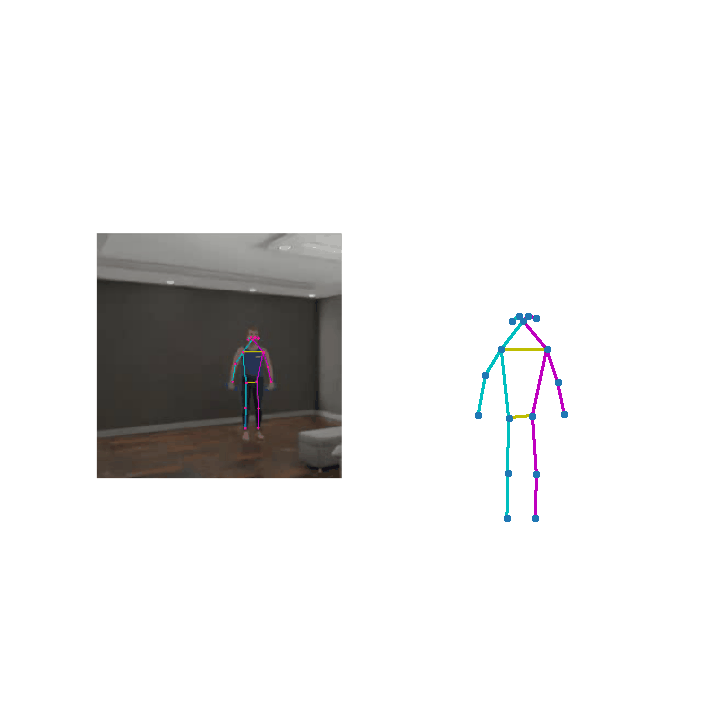

In [22]:
Image(open(r'C:\MLprojects\motion_analysis\data\infinity\InfinityAI_InfiniteRep_armraise_v1.0\data\000000.mp4_test_thunder4.gif','rb').read())

seems to have some issues but amenable to processing

#### compile data

In [23]:
structshape.getshape(infinityds_mp4paths_armmotion)
data_all, skippct, skippedpaths = iomod.compile_data_wrapper(infinityds_mp4paths_armmotion)

FileNotFoundError, Skipping data\infinity\InfinityAI_InfiniteRep_curl_v1.0\data\000092.mp4
FileNotFoundError, Skipping data\infinity\InfinityAI_InfiniteRep_curl_v1.0\data\000093.mp4
FileNotFoundError, Skipping data\infinity\InfinityAI_InfiniteRep_curl_v1.0\data\000094.mp4
FileNotFoundError, Skipping data\infinity\InfinityAI_InfiniteRep_curl_v1.0\data\000095.mp4
FileNotFoundError, Skipping data\infinity\InfinityAI_InfiniteRep_curl_v1.0\data\000096.mp4
FileNotFoundError, Skipping data\infinity\InfinityAI_InfiniteRep_curl_v1.0\data\000097.mp4
FileNotFoundError, Skipping data\infinity\InfinityAI_InfiniteRep_curl_v1.0\data\000098.mp4
FileNotFoundError, Skipping data\infinity\InfinityAI_InfiniteRep_curl_v1.0\data\000099.mp4
FileNotFoundError, Skipping data\infinity\InfinityAI_InfiniteRep_fly_v1.0\data\000000.mp4
FileNotFoundError, Skipping data\infinity\InfinityAI_InfiniteRep_fly_v1.0\data\000001.mp4
FileNotFoundError, Skipping data\infinity\InfinityAI_InfiniteRep_fly_v1.0\data\000002.mp4
Fi

In [24]:
# remove skipped paths from infinityds_mp4paths_armmotion
infinityds_mp4paths_armmotion = [path for path in infinityds_mp4paths_armmotion if path not in skippedpaths]

note that fly pose data was not collected into pickl files, so will first test on arm and curl mainly

In [25]:
test_path = infinityds_mp4paths_armmotion[2]
# structshape.getshape(data_all["out_keypoints"][test_path]) # 'array of ndarray with shape=(284, 1, 1, 17, 3)'
# structshape.getshape(data_all["out_edges"][test_path]) # 'array of ndarray with shape=(284, 18, 2, 2)'

In [26]:
# reshape data_all keypoints into 3-d array
data_reshaped = {}
data_reshaped["out_keypoints"] = {}

for test_path in infinityds_mp4paths_armmotion:
  original = data_all["out_keypoints"][test_path]
  print(f"{original=}", structshape.getshape(original))
  reshaped = data_all["out_keypoints"][test_path].reshape(-1, 17, 3)
  print(f"{reshaped=}", structshape.getshape(reshaped))
  data_reshaped["out_keypoints"][test_path] = reshaped

original=array([[[[[0.42938879, 0.63432217, 0.54826123],
          [0.41992122, 0.64359379, 0.48933151],
          [0.42020074, 0.62609416, 0.44831306],
          ...,
          [0.70821899, 0.60546589, 0.37468556],
          [0.79146701, 0.65686309, 0.4151451 ],
          [0.79123819, 0.60434967, 0.29411638]]]],



       [[[[0.4219912 , 0.63988769, 0.82147741],
          [0.41419777, 0.64851248, 0.69382685],
          [0.41273329, 0.63042039, 0.76830274],
          ...,
          [0.71198481, 0.61022192, 0.66586381],
          [0.80153102, 0.65756679, 0.67239118],
          [0.80300629, 0.6087392 , 0.78747326]]]],



       [[[[0.42249802, 0.63832998, 0.74476165],
          [0.41401127, 0.64670032, 0.76877588],
          [0.4142381 , 0.62987924, 0.74575573],
          ...,
          [0.70743191, 0.61071938, 0.78352815],
          [0.79984087, 0.65958565, 0.77738285],
          [0.80014026, 0.60720336, 0.65010267]]]],



       ...,



       [[[[0.42378786, 0.63874847, 0.7434842 ],
 

In [27]:
# collect third dimension of data_reshaped["out_keypoints"][test_path].shape
confidence_values_all = []
for test_path in infinityds_mp4paths_armmotion:
  confidence_values = data_reshaped["out_keypoints"][test_path][:,:,2]
  confidence_values_all.append(confidence_values)
confidence_values_all[0].shape

(578, 17)

#### plot histogram of confidence values, cumulative

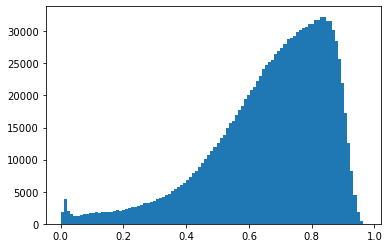

In [28]:
# concatenate & plot histogram of confidence values

# concat list into one array, then flatten
confidence_values_all_cat = np.concatenate(confidence_values_all, axis=0).reshape(-1)
plt.hist(confidence_values_all_cat, bins=100)
plt.show()


appears to be skewed toward higher confidence values, so perhaps consider 0.2 or 0.4 as threshold to remove outlier keypoint predictions

#### load into df for storage

In [29]:
df_kpts = pd.DataFrame({"path": infinityds_mp4paths_armmotion})
# match path and load data_reshaped
df_kpts["out_keypoints"] = [data_reshaped["out_keypoints"][path] for path in infinityds_mp4paths_armmotion]
  # frame, keypoint, (y, x, confidence)
df_kpts["out_edges"] = [data_all["out_edges"][path] for path in infinityds_mp4paths_armmotion]
  # frame, (connectivity pair tuple) as key,  array of x-y arrays

In [30]:
df_kpts["out_keypoints"][0][1, 1:4, :]

array([[0.41419777, 0.64851248, 0.69382685],
       [0.41273329, 0.63042039, 0.76830274],
       [0.42233419, 0.65591145, 0.78464806]])

In [31]:
df_kpts["out_edges"][0][1, :, :]

array([[[143.33483887,  94.52603149],
        [145.26679993,  92.78030396]],

       [[143.33483887,  94.52603149],
        [141.21417236,  92.45225525]],

       [[143.33483887,  94.52603149],
        [152.35317993, 105.82678223]],

       [[143.33483887,  94.52603149],
        [131.90597534, 105.21237946]],

       [[145.26679993,  92.78030396],
        [146.92416382,  94.6028595 ]],

       [[141.21417236,  92.45225525],
        [137.91320801,  94.07154846]],

       [[152.35317993, 105.82678223],
        [131.90597534, 105.21237946]],

       [[152.35317993, 105.82678223],
        [157.22987366, 121.39777374]],

       [[152.35317993, 105.82678223],
        [148.16567993, 133.89428711]],

       [[131.90597534, 105.21237946],
        [125.99433899, 120.13768768]],

       [[131.90597534, 105.21237946],
        [136.64512634, 133.7674408 ]],

       [[157.22987366, 121.39777374],
        [159.83346558, 135.58802795]],

       [[125.99433899, 120.13768768],
        [123.39776611, 135

#### compute & plot histograms of pairwise distances
out_edges is an (frame, edge-pair,  array of x-y arrays) where np.array([[x_start, y_start], [x_end, y_end]]) so should be able to simply plot histogram of each of these distances directly (as opposed to, e.g., calculating non-connected pairwise distances)

note: ran some tests for unexpected dimension after tuple indexing - it appears as long as you integer index instead of tuple index into the orderedDict within out_edges you will avoid unexpected behavior of (2,2,2) matrix and instead get the expected (2,2) start-end matrix. Using e.g. list(CONFIG_EDGE_COLORS).index((2,4)) to get index of edge color seems to be appropriate

In [32]:
from itertools import product
from scipy.spatial.distance import pdist, squareform
from scipy.stats import pearsonr

In [33]:
edge_idx = 0
# list(CONFIG_KEYPOINTS)[edge_tuple[0]]
edge_tuple = list(CONFIG_EDGE_COLORS)[edge_idx]
print(f"{edge_tuple=}", structshape.getshape(edge_tuple))
kpt1_name = list(CONFIG_KEYPOINTS)[edge_tuple[0]]
print(f"{kpt1_name=}", structshape.getshape(kpt1_name))
kpt2_name = list(CONFIG_KEYPOINTS)[edge_tuple[1]]
print(f"{kpt2_name=}", structshape.getshape(kpt2_name))

edge_tuple=(0, 1) tuple of 2 int
kpt1_name='nose' str
kpt2_name='left_eye' str


In [34]:
# loop over all out_edges and compute pdist of each edge
edge_length_all = {}
edge_names = []
num_edges = 18

# map edge connectivity keys onto keypoint names for display
for edge_idx in range(num_edges):
  edge_tuple = list(CONFIG_EDGE_COLORS)[edge_idx]
  kpt1_name = list(CONFIG_KEYPOINTS)[edge_tuple[0]]
  kpt2_name = list(CONFIG_KEYPOINTS)[edge_tuple[1]]
  name = f"{kpt1_name}-{kpt2_name}"
  edge_names.append(name)


In [35]:
edge_names

['nose-left_eye',
 'nose-right_eye',
 'nose-left_shoulder',
 'nose-right_shoulder',
 'left_eye-left_ear',
 'right_eye-right_ear',
 'left_shoulder-right_shoulder',
 'left_shoulder-left_elbow',
 'left_shoulder-left_hip',
 'right_shoulder-right_elbow',
 'right_shoulder-right_hip',
 'left_elbow-left_wrist',
 'right_elbow-right_wrist',
 'left_hip-right_hip',
 'left_hip-left_knee',
 'right_hip-right_knee',
 'left_knee-left_ankle',
 'right_knee-right_ankle']

In [36]:

# initialize dictionary to store cumulatively edge distances
for name in edge_names:
  edge_length_all[name] = []

# loop over paths, frames, edge-pair types  
for path in infinityds_mp4paths_armmotion:
  for fri in range(data_all["out_edges"][path].shape[0]):
    for edge_idx in range(num_edges):
      # edge_pair indexing as integer *don't use tuple!
      edgesfri = data_all["out_edges"][path][fri, edge_idx, :, :]
      pdist_fri = pdist(edgesfri, 'euclidean').astype(np.float32)[0]

      name = edge_names[edge_idx]
      edge_length_all[name].append(pdist_fri)


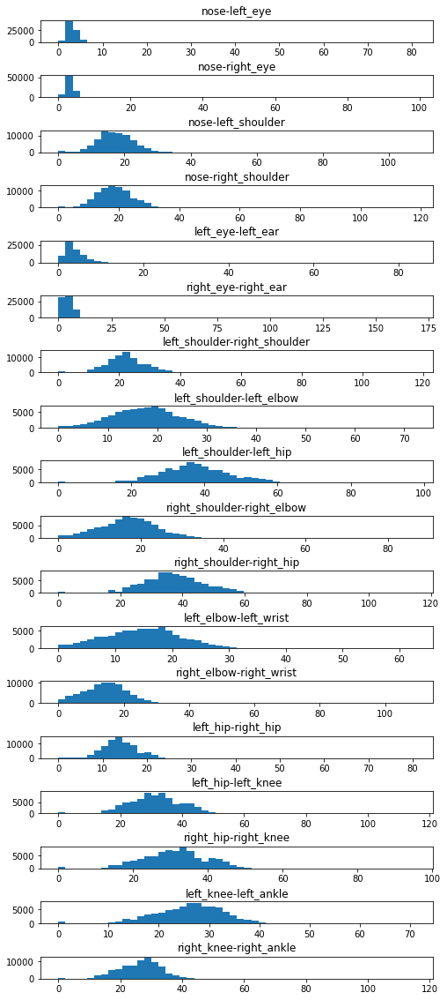

In [37]:
plt.figure(figsize=(8, 20)) # width, height
# increase subplot spacing
plt.subplots_adjust(hspace=1.5)

for edge_idx in range(num_edges):
  name = edge_names[edge_idx]
  plt.subplot(num_edges, 1, edge_idx+1)
  plt.hist(edge_length_all[name], bins=50)
  plt.title(name)


edge distances seem ostensibly okay, with bilaterally symmetrical distances and appropriately shorter distances around face

In [38]:
# do same with all velocities
# loop over all out_edges and compute pdist of each edge
edge_vel_all = {name:[] for name in edge_names}

# loop over paths, frames, edge-pair types  
for path in infinityds_mp4paths_armmotion:
  for fri in range(data_all["out_edges"][path].shape[0]):
    for edge_idx in range(1, num_edges):
      # edge_pair indexing as integer *don't use tuple!
      edgesfri = data_all["out_edges"][path][fri, edge_idx, :, :]
      edgesfriprev = data_all["out_edges"][path][fri-1, edge_idx, :, :]
      pdist_fri = pdist([np.mean(edgesfri, axis=0), np.mean(edgesfriprev, axis=0)], \
      'euclidean').astype(np.float32)[0]

      name = edge_names[edge_idx]
      edge_vel_all[name].append(pdist_fri)
      


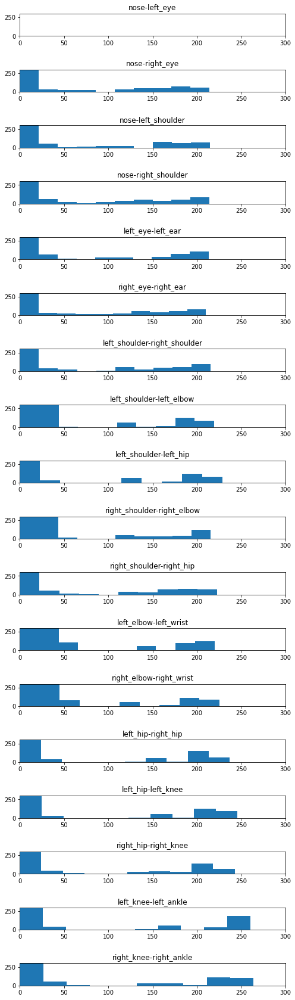

In [39]:
plt.figure(figsize=(8, 30)) # width, height
# increase subplot spacing
plt.subplots_adjust(hspace=1.5)

for edge_idx in range(num_edges):
  name = edge_names[edge_idx]
  plt.subplot(num_edges, 1, edge_idx+1)
  plt.hist(edge_vel_all[name])
  plt.xlim(0, 300)
  plt.ylim(0, 300)
  plt.title(name)

vast majority are <10, however some outliers here > 25 ~ approximately 1% of all frames (~60k), suggesting useable for initial tests. But can do some video-by-video rejection

In [ ]:
# save all
with open(f"df_kpts", 'wb') as f:
  pkl.dump(df_kpts, f)
with open(f"edge_vel_all", 'wb') as f:
  pkl.dump(edge_vel_all, f)
with open(f"edge_length_all", 'wb') as f:
  pkl.dump(edge_length_all, f)

# note may be copies in data\compiled

In [40]:
import fnmatch

# load all
with open(r"data\compiled\df_kpts", 'rb') as f:
  df_kpts = pkl.load(f)
with open(r"data\compiled\edge_vel_all", 'rb') as f:
  edge_vel_all = pkl.load(f)
with open(r"data\compiled\edge_length_all", 'rb') as f:
  edge_length_all = pkl.load(f)

infinityds_mp4paths = glob.glob("data\**\*.mp4", recursive=True)
armidx = [path for path in infinityds_mp4paths if "arm" in path]
curlidx = [path for path in infinityds_mp4paths if "curl" in path]

# concatenate all the paths
infinityds_mp4paths_armmotion = armidx + curlidx
infinityds_mp4paths_armmotion

# remove for now jitter or bilateral swapping or other poor quality issues (visualized with x-y plots below)
remove_pattern = ["*armraise*000004.mp4", "*armraise*000005.mp4", "*armraise*000006.mp4", "*armraise*000009.mp4", "*armraise*000013.mp4", "*armraise*000018.mp4", \
  "*armraise*000019.mp4", "*armraise*000033.mp4", "*armraise*000039.mp4", "*armraise*000042.mp4", "*armraise*000044.mp4", "*armraise*000066.mp4", "*armraise*000076.mp4", "*armraise*000094.mp4", "*armraise*000097.mp4", "*armraise*000099.mp4",
  "*armraise*000025.mp4", "*armraise*000044.mp4", "*armraise*000035.mp4", "*armraise*000026.mp4", "*armraise*000020.mp4", \
  "*curl*000001.mp4", "*curl*000022.mp4", "*curl*000025.mp4", "*curl*000034.mp4", "*curl*000035.mp4", "*curl*000043.mp4", "*curl*000049.mp4", \
  "*curl*000053.mp4", "*curl*000056.mp4", "*curl*000057.mp4", "*curl*000060.mp4", "*curl*000061.mp4", "*curl*000068.mp4", "*curl*000080.mp4", \
  "*curl*000080.mp4", "*curl*000082.mp4", "*curl*000090.mp4",]

# remove from list
infinityds_mp4paths_armmotion_rmv = [path for path in infinityds_mp4paths_armmotion \
  if not any(fnmatch.fnmatch(path, r) for r in remove_pattern)]

data_all, skippct, skippedpaths = iomod.compile_data_wrapper(infinityds_mp4paths_armmotion_rmv)

# remove skipped paths from infinityds_mp4paths_armmotion
infinityds_mp4paths_armmotion_rmv = [path for path in infinityds_mp4paths_armmotion_rmv if path not in skippedpaths]

FileNotFoundError, Skipping data\infinity\InfinityAI_InfiniteRep_curl_v1.0\data\000092.mp4
FileNotFoundError, Skipping data\infinity\InfinityAI_InfiniteRep_curl_v1.0\data\000093.mp4
FileNotFoundError, Skipping data\infinity\InfinityAI_InfiniteRep_curl_v1.0\data\000094.mp4
FileNotFoundError, Skipping data\infinity\InfinityAI_InfiniteRep_curl_v1.0\data\000095.mp4
FileNotFoundError, Skipping data\infinity\InfinityAI_InfiniteRep_curl_v1.0\data\000096.mp4
FileNotFoundError, Skipping data\infinity\InfinityAI_InfiniteRep_curl_v1.0\data\000097.mp4
FileNotFoundError, Skipping data\infinity\InfinityAI_InfiniteRep_curl_v1.0\data\000098.mp4
FileNotFoundError, Skipping data\infinity\InfinityAI_InfiniteRep_curl_v1.0\data\000099.mp4


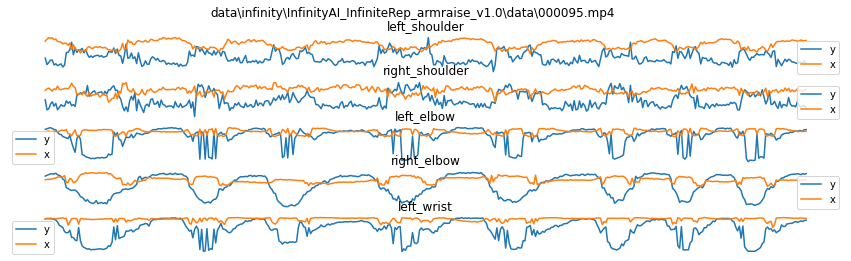

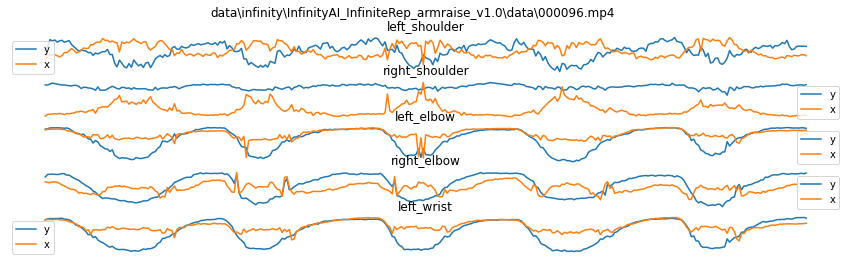

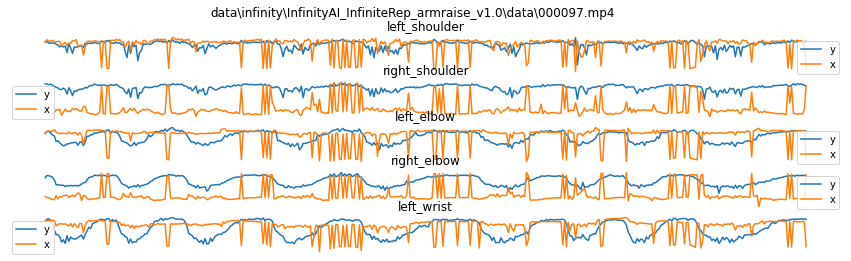

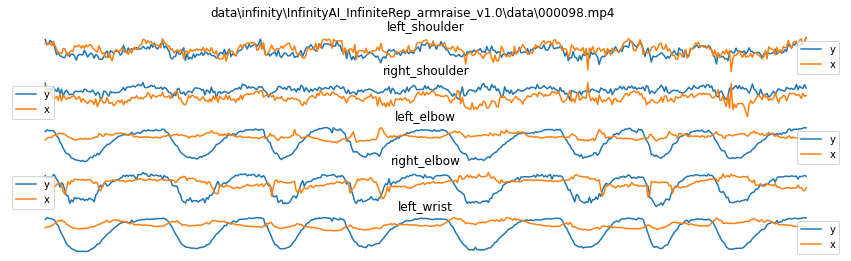

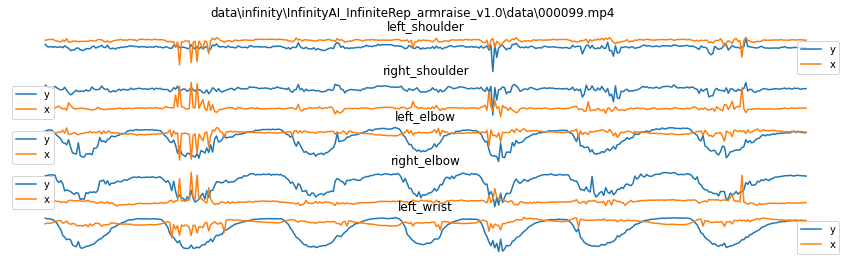

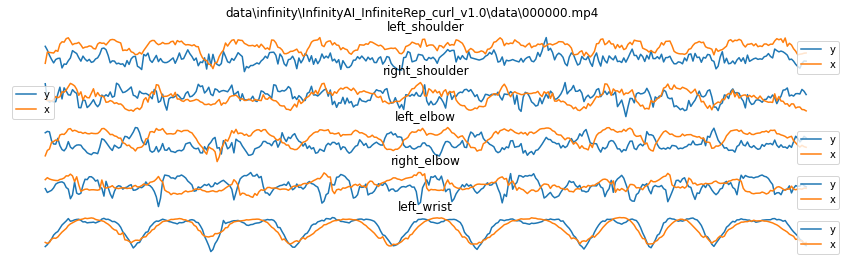

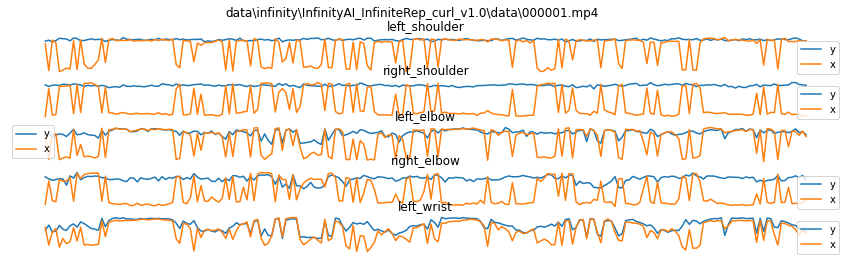

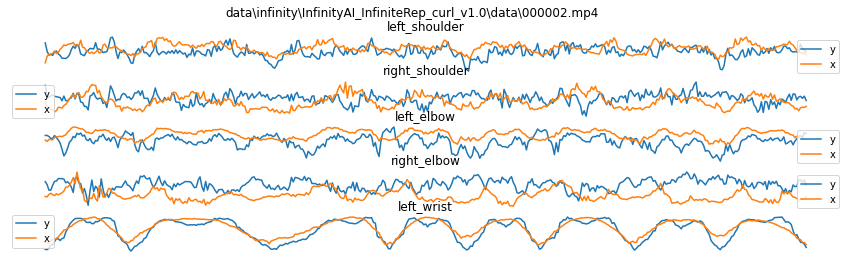

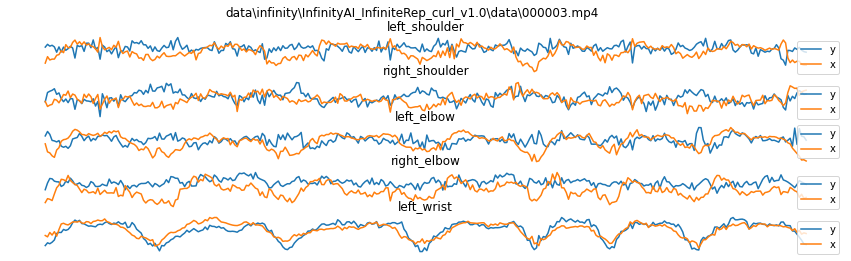

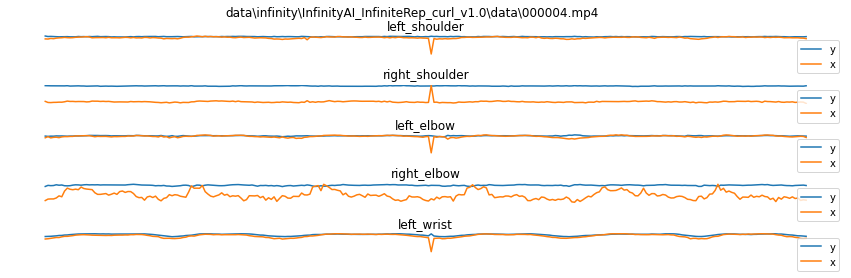

In [41]:
# plot peak normalized x-y coordinates of relevant upper torso keypoints
num_kpts = 17
analyze_pathidx = range(95, 105)
analyze_kptsidx = range(5, 10)
num_paths = len(df_kpts.out_keypoints)

for pathidx in analyze_pathidx:
  plt.figure(figsize=(15, 4))
  plt.suptitle(df_kpts.loc[pathidx, 'path'])
    
  # fr, 17, 3
  for subi, i in enumerate(analyze_kptsidx):
    plt.subplot(5, 1, subi+1)
    plt.plot(np.arange(len(df_kpts.out_keypoints[pathidx])), df_kpts.out_keypoints[pathidx][:,i,0] / np.max(df_kpts.out_keypoints[pathidx][:,i,0]))
    plt.plot(np.arange(len(df_kpts.out_keypoints[pathidx])), df_kpts.out_keypoints[pathidx][:,i,1] / np.max(df_kpts.out_keypoints[pathidx][:,i,1]))
    plt.title(f"{list(CONFIG_KEYPOINTS)[i]}")
    plt.axis('off')
    plt.legend(['y', 'x'])
  
plt.subplots_adjust(hspace=1.5)
plt.rcParams.update({'font.size': 10})


initial thoughts:
- there is some rapid bilateral switching in some cases, suggesting out-of-the-box implementation needs quality improvement
- some may be already useable if some segmentation or data generalization
- perhaps x-y correlation or edge-edge correlation could be constructed feature to use for action classification